<a href="https://colab.research.google.com/github/datacorner/les-tutos-datacorner.fr/blob/master/XAI/Interpretation_modele.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from sklearn.datasets import fetch_california_housing
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression 
from sklearn.metrics import mean_squared_error,r2_score,explained_variance_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from math import sqrt

from google.colab import data_table

# Display smart tables into colab ;-)
data_table.enable_dataframe_formatter()

# Data collect

In [12]:
#X, y = fetch_california_housing(as_frame=True, return_X_y=True)
train = pd.read_csv('/content/sample_data/california_housing_train.csv')
test = pd.read_csv('/content/sample_data/california_housing_test.csv')
all_data = pd.concat([train, test], axis=0)
print(all_data.columns)

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value'],
      dtype='object')


In [13]:
all_data.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value'],
      dtype='object')

In [14]:
all_data.shape

(20000, 9)

In [16]:
all_data

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,1.4936,66900.0
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,1.8200,80100.0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,1.6509,85700.0
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,3.1917,73400.0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,1.9250,65500.0
...,...,...,...,...,...,...,...,...,...
2995,-119.86,34.42,23.0,1450.0,642.0,1258.0,607.0,1.1790,225000.0
2996,-118.14,34.06,27.0,5257.0,1082.0,3496.0,1036.0,3.3906,237200.0
2997,-119.70,36.30,10.0,956.0,201.0,693.0,220.0,2.2895,62000.0
2998,-117.12,34.10,40.0,96.0,14.0,46.0,14.0,3.2708,162500.0


# Check null values & first data views

In [17]:
all_data.isnull().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
dtype: int64

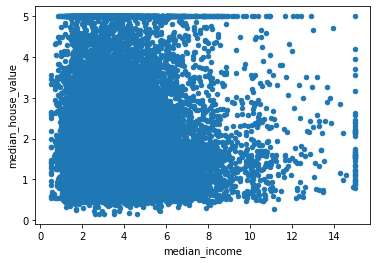

In [21]:
all = all_data.copy()
all["median_house_value"] = y
all.plot.scatter("median_income", "median_house_value")

# Prepare data

In [22]:
scaler = StandardScaler()
def prepare_data(data, scale=True):
  names = data.columns
  if (scale == True):
    scaled_data = scaler.fit_transform(data)
    data = pd.DataFrame(scaled_data, columns=names)
  y_label = ["median_house_value"]
  X = data[names]
  del X["median_house_value"]
  y = data[y_label]
  x_train,x_test,y_train,y_test=train_test_split(X, y, test_size=0.2, random_state=1)
  return x_train,x_test,y_train,y_test

# Classic Regression

## Fit without scaling data

In [24]:
x_train,x_test,y_train,y_test = prepare_data(all_data, False)

reg = LinearRegression()
reg.fit(x_train, y_train)
y_test_prediction = reg.predict(x_test)
print(f"Score / training data: {round(reg.score(x_train, y_train)*100, 1)} %")
print(f"Score / test data: {round(reg.score(x_test, y_test)*100, 10)} %")

Score / training data: 0.8 %
Score / test data: 1.1808691466 %


R-Squared of 62% means 62% only of our data fits with the model !  
Score like that & MSE does not mean anything as we need to scale our data first to get better insight

## Fit with scaled data

In [25]:
x_train,x_test,y_train,y_test = prepare_data(all_data, True)

reg = LinearRegression()
reg.fit(x_train, y_train)
y_test_prediction = reg.predict(x_test)
print(f"Score / training data: {round(reg.score(x_train, y_train)*100, 1)} %")
print(f"Score / test data: {round(reg.score(x_test, y_test)*100, 1)} %")

Score / training data: 64.2 %
Score / test data: 62.3 %


# Random forest Regression

## Without changing the dataset

In [ ]:
x_train,x_test,y_train,y_test = prepare_data(all_data, True)

rforest = RandomForestRegressor()
rforest.fit(x_train, y_train)
print(f"Score / training data: {round(rforest.score(x_train, y_train)*100, 1)} %")
print(f"Score / test data: {round(rforest.score(x_test, y_test)*100, 1)} %")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  after removing the cwd from sys.path.


Score / training data: 97.5 %
Score / test data: 81.1 %


In [ ]:
y_test_prediction = rforest.predict(x_test)
mean_squared_error(y_test_prediction, y_test)

0.1850790794285264

97% is definitely a too good score comparing to the test data (81%) ! we overfit here ... but why ?

   Feature Importance        Feature Name
7            0.519928       median_income
0            0.160221           longitude
1            0.152252            latitude
2            0.062846  housing_median_age
5            0.035167          population
4            0.026243      total_bedrooms
3            0.024440         total_rooms
6            0.018905          households


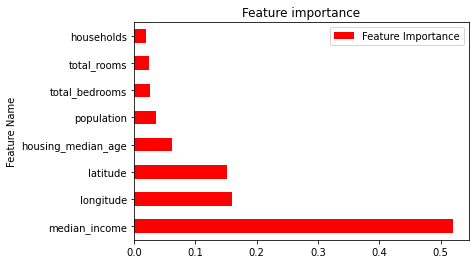

In [ ]:
def display_feat_imp(rforest):
  feat_imp = rforest.feature_importances_
  df_featimp = pd.DataFrame(feat_imp, columns = {"Feature Importance"})
  df_featimp["Feature Name"] = x_train.columns
  df_featimp = df_featimp.sort_values(by="Feature Importance", ascending=False)
  print(df_featimp)
  df_featimp.plot.barh(y="Feature Importance", x="Feature Name", title="Feature importance", color="red")

display_feat_imp(rforest)

Clearly the feature median_income takes a very important place in the final decision (52%)

## Try by changing the median_income feature by a simple rank

In [ ]:
all_data["median_income"].describe()

count    20000.000000
mean         3.872132
std          1.900356
min          0.499900
25%          2.562500
50%          3.536000
75%          4.745325
max         15.000100
Name: median_income, dtype: float64

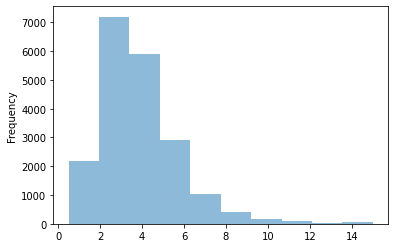

In [ ]:
all_data["median_income"].plot.hist(alpha=0.5)

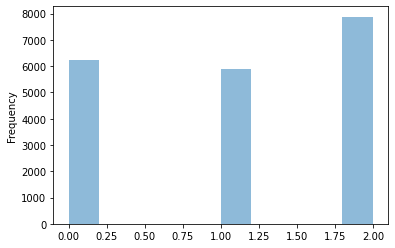

In [ ]:
def rankincome(income):
  if (income) >= 4:
    return 2
  elif (income) >= 2.8:
    return 1
  else:
    return 0

all_data_2 = all_data.copy()
all_data_2["income_rank"] = [rankincome(x) for x in all_data["median_income"]]
del all_data_2['median_income']
all_data_2["income_rank"].plot.hist(alpha=0.5)

In [ ]:
all_data_2

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_house_value,income_rank
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,66900.0,0
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,80100.0,1
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,85700.0,0
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,73400.0,2
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,65500.0,1
...,...,...,...,...,...,...,...,...,...
2995,-119.86,34.42,23.0,1450.0,642.0,1258.0,607.0,225000.0,0
2996,-118.14,34.06,27.0,5257.0,1082.0,3496.0,1036.0,237200.0,2
2997,-119.70,36.30,10.0,956.0,201.0,693.0,220.0,62000.0,1
2998,-117.12,34.10,40.0,96.0,14.0,46.0,14.0,162500.0,2


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  after removing the cwd from sys.path.


Score / training data: 97.3 %
Score / test data: 80.3 %
   Feature Importance        Feature Name
7            0.329712         income_rank
0            0.234911           longitude
1            0.228035            latitude
2            0.056449  housing_median_age
3            0.050357         total_rooms
5            0.045734          population
4            0.028160      total_bedrooms
6            0.026642          households


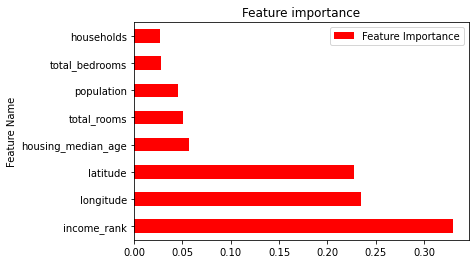

In [ ]:
x_train,x_test,y_train,y_test = prepare_data(all_data_2, True)

rforest = RandomForestRegressor()
rforest.fit(x_train, y_train)
print(f"Score / training data: {round(rforest.score(x_train, y_train)*100, 1)} %")
print(f"Score / test data: {round(rforest.score(x_test, y_test)*100, 1)} %")

display_feat_imp(rforest)

In [ ]:
import statistics
statistics.pvariance(all_data_2["income_rank"])

0.69940876

In [ ]:
from sklearn.feature_selection import VarianceThreshold
threshold_n=0.95
sel = VarianceThreshold(threshold=(threshold_n* (1 - threshold_n) ))
sel_var=sel.fit_transform(all_data_2)
all_data_2[all_data_2.columns[sel.get_support(indices=True)]] 

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_house_value,income_rank
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,66900.0,0
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,80100.0,1
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,85700.0,1
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,73400.0,2
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,65500.0,1
...,...,...,...,...,...,...,...,...,...
2995,-119.86,34.42,23.0,1450.0,642.0,1258.0,607.0,225000.0,0
2996,-118.14,34.06,27.0,5257.0,1082.0,3496.0,1036.0,237200.0,2
2997,-119.70,36.30,10.0,956.0,201.0,693.0,220.0,62000.0,1
2998,-117.12,34.10,40.0,96.0,14.0,46.0,14.0,162500.0,2


In [ ]:
pd.DataFrame(sel_var)

,0,1,2,3,4,5,6,7,8
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,66900.0,0.0
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,80100.0,1.0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,85700.0,1.0
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,73400.0,2.0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,65500.0,1.0
...,...,...,...,...,...,...,...,...,...
19995,-119.86,34.42,23.0,1450.0,642.0,1258.0,607.0,225000.0,0.0
19996,-118.14,34.06,27.0,5257.0,1082.0,3496.0,1036.0,237200.0,2.0
19997,-119.70,36.30,10.0,956.0,201.0,693.0,220.0,62000.0,1.0
19998,-117.12,34.10,40.0,96.0,14.0,46.0,14.0,162500.0,2.0
